##  TOC 

- [0. Business Understanding](#Business-Understanding)  
- [1. Taking Business Goal](#Taking-Business-Goal)  
- [2. Problem Statement](#Problem-Statement)  


## Table of Contents

1. [Data Collection](#Data-Collection)
2. [Data Loading](#Data-Loading)
3. [Data Overview](#Data-Overview)
4. [Data Validation and Normalization](#Data-Validation-and-Normalization)  
5. [EDA](#EDA)  
   - [Types of Variables](#Types-of-Variables)
   - [Univariate](#Univariate)  
   - [Bivariate](#Bivariate)
   - [Multivariate](#Multivariate)
6. [overall Insights and Summary](#overall-Insights-and-Summary)
7. [Conclusion](#Conclusion)


# Exploratory Data Analysis: 

## Table of Contents 

1. [Introduction](#Introduction)
2. [Data Loading](#Data-Loading)
3. [Data Overview](#Data-Overview)
4. [Univariate Analysis](#Univariate-Analysis)
5. [Bivariate Analysis](#Bivariate-Analysis)
6. [Multivariate Analysis](#Multivariate-Analysis)
7. [Insights and Summary](#Insights-and-Summary)


Introduction:
This notebook performs Exploratory Data Analysis (EDA) on the Real Estate Dataset, uncovering patterns, trends, and key insights using both static and interactive visualizations.


##  Introduction to the Real Estate Dataset
Real estate data includes information about property listings, prices, ownership, and features like BHK, area, and location.
It also covers market trends and rental/sales records.
Disaster information like flood, earthquake, or cyclone risk helps assess investment safety.
This data guides investors and developers in making smart decisions.



##  Key Features of the Dataset:
Feature	Description


| Feature              | Description |
|----------------------|-------------|
| **State, District, Location** | Shows the name of the state, district, and specific location where the property is located. |
| **Price**            | The total cost of the property, represented in Indian Rupees. |
| **Total_Area**       | Total area of the property in square feet. |
| **Price_per_SQFT**   | Price per square foot, calculated by dividing Price by Total_Area. |
| **BHK**              | Number of Bedrooms, Hall, and Kitchen units (e.g., 2BHK = 2 Bedrooms + 1 Hall + 1 Kitchen). |
| **Baths**            | Total number of bathrooms available in the house. |
| **Balcony**          | Number of balconies the house has (values like 0, 1, 2...). |
| **Disaster**         | Type of natural disaster risk in the region (Flood, Cyclone, etc.). |
| **Temperature (°C)** | Average temperature in the property's district (e.g., 30°C). |
| **Humidity (%)**     | Percentage of moisture present in the air (e.g., 70%). |
| **Wind Speed (km/h)**| Average wind speed in the district, measured in km/h (e.g., 15 km/h). |
| **Location**         | Specific area or locality name within the district (e.g., Gachibowli, Kukatpally). |


###  Objective of the Analysis

• Understand how property price is related to BHK, area, and location  
• Study how weather and disaster risks impact real estate trends  
• Rank regions based on livability, climate safety, and affordability  
• Use advanced visualizations to explore real estate patterns


## Business Understanding
The real estate industry plays a big role in the growth of cities and the economy. People who want to buy or invest in houses—and even the government—are now paying more attention to things like temperature, humidity, and natural disasters, because these can affect the price and comfort of a home.

This dataset helps us understand how house features, location, and weather conditions together affect property prices. The goal is to give clear, useful insights through data and visuals, so we can see what makes some houses more attractive or risky than others.



## Taking Business Goal


The main aim of this project is to study real estate data from different districts and states to find out what factors affect property prices the most. This includes looking at:

• House features like total area, number of BHKs, and bathrooms  
• Environmental factors such as temperature, humidity, and natural disaster risks  
• Location details like the state and district


## Problem Statement

How do house features, weather conditions, and disaster risks affect property prices and listings across different Indian states?
We aim to:
- Analyze property prices based on features like number of BHKs, area, balconies, and bathrooms.  
- Study the impact of natural disasters such as floods and cyclones on property values.  
- Identify the most livable regions by comparing climate and safety conditions.  
- Use univariate, bivariate, and multivariate analysis to discover useful patterns.  
- Visualize property trends using sunburst charts and other advanced graphs.  
- Provide meaningful insights to support better real estate investment and urban planning.


## Introduction

In [12]:
pip install mysql-connector-python pandas


Note: you may need to restart the kernel to use updated packages.


## Data Collection


In [14]:
import pandas as pd
import numpy as np
from sqlalchemy import create_engine
import mysql.connector
import plotly.express as px

## Data Loading

import sys
!{sys.executable} -m pip install pymysql

In [17]:
import mysql.connector
import pandas as pd

# Create connection
df=mysql.connector.connect(
    username='root',
    password='Rambabu@123',
    host='localhost',
    database='real_estate')
da='select  * from real_estate_ds'
df=pd.read_sql(da,con=df)
df
# Load data using SQL query (not just the table name)

# Display the DataFrame
print(df.head())


   MyUnknownColumn                                  Location       Price  \
0                0             Kanathur Reddikuppam, Chennai  19900000.0   
1                1     Ramanathan Nagar, Pozhichalur,Chennai  22500000.0   
2                2  Kasthuribai Nagar, West Tambaram,Chennai  10000000.0   
3                3   Naveenilaya,Chepauk, Triplicane,Chennai  33300000.0   
4                4                            Avadi, Chennai   4800000.0   

   Total_Area  Price_per_SQFT  Baths Balcony   BHK       State  Year  \
0        2583          7700.0      4     Yes   4.0  Tamil Nadu  2005   
1        7000          3210.0      6     Yes  10.0  Tamil Nadu  2005   
2        1320          7580.0      3      No   3.0  Tamil Nadu  2005   
3        4250          7840.0      5     Yes   7.0  Tamil Nadu  2005   
4         960          5000.0      3     Yes   2.0  Tamil Nadu  2005   

   District  Temperature (Â°C) Condition  Humidity (%)  Wind Speed (km/h)  \
0  Ariyalur               24.3   

C:\Users\nisha\AppData\Local\Temp\ipykernel_7772\3205082207.py:11: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df=pd.read_sql(da,con=df)


In [18]:
df.rename(columns = {"Temperature (Â°C)":"Temperature (°C)"},inplace = True)

In [23]:
def custom_score(row):
    # Ideal temperature range: 18°C–30°C
    temp_score = 1 if 18 <= row['Temperature (°C)'] <= 30 else 0
    
    # Ideal humidity: 30%–70%
    humidity_score = 1 if 30 <= row['Humidity (%)'] <= 70 else 0

    # Ideal wind speed: less than 30 km/h
    wind_score = 1 if row['Wind Speed (km/h)'] <= 30 else 0

    # Disaster risk: Penalize risky areas
    disaster_score = 0 if row['Disaster'] in ['Flood', 'Cyclone'] else 1

    # Property quality: More BHK, Baths, Balcony → better score
    bhk_score = min(row['BHK'] / 5, 1)      # Max 5 BHK = score 1
    bath_score = min(row['Baths'] / 4, 1)   # Max 4 Baths = score 1         # Already binary 0 or 1

    # Optional: Invert price (cheaper = better, normalized later)
    # You can scale Price to 0–1 using min-max scaling if needed

    # Final weighted sum (can ajust weights)
    total_score = (temp_score + humidity_score + wind_score +
                   disaster_score + bhk_score + bath_score)
    
    return total_score


In [25]:
df['Custom_Score'] = df.apply(custom_score, axis=1)


In [27]:
df

,MyUnknownColumn,Location,Price,Total_Area,Price_per_SQFT,Baths,Balcony,BHK,State,Year,District,Temperature (°C),Condition,Humidity (%),Wind Speed (km/h),Disaster,Custom_Score
0,0,"Kanathur Reddikuppam, Chennai",19900000.0,2583,7700.0,4,Yes,4.0,Tamil Nadu,2005,Ariyalur,24.3,Mist,89,10.1,stampede,4.80
1,1,"Ramanathan Nagar, Pozhichalur,Chennai",22500000.0,7000,3210.0,6,Yes,10.0,Tamil Nadu,2005,Ariyalur,24.3,Mist,89,10.1,stampede,5.00
2,2,"Kasthuribai Nagar, West Tambaram,Chennai",10000000.0,1320,7580.0,3,No,3.0,Tamil Nadu,2005,Ariyalur,24.3,Mist,89,10.1,stampede,4.35
3,3,"Naveenilaya,Chepauk, Triplicane,Chennai",33300000.0,4250,7840.0,5,Yes,7.0,Tamil Nadu,2005,Ariyalur,24.3,Mist,89,10.1,stampede,5.00
4,4,"Avadi, Chennai",4800000.0,960,5000.0,3,Yes,2.0,Tamil Nadu,2005,Ariyalur,24.3,Mist,89,10.1,stampede,4.15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4168,4184,"Hari vihar,Sector 16 Dwarka, New Delhi",4500000.0,450,10000.0,2,No,1.0,Delhi,2016,Central Delhi,15.3,Mist,72,9.4,smog,2.70
4169,4185,"Sector 15B, Sector 15 Rohini,New Delhi",7000000.0,900,7780.0,3,No,3.0,Delhi,2016,Central Delhi,15.3,Mist,72,9.4,smog,3.35
4170,4186,"Bulder floor,Jaitpur, New Delhi",900000.0,200,4500.0,1,No,1.0,Delhi,2016,Central Delhi,15.3,Mist,72,9.4,smog,2.45
4171,4187,"Krishna Park Extension, Tilak Nagar,New Delhi",4000000.0,1053,3800.0,3,Yes,2.0,Delhi,2016,Central Delhi,15.3,Mist,72,9.4,smog,3.15


## Data Overview


### 📊 Data Overview

| **Category**         | **Description**                                                                 |
|----------------------|---------------------------------------------------------------------------------|
|  Property Structure | BHK, Total Area, Baths, Balconies, and Price                                   |
| Location           | State, District, and Locality                                                   |
| Weather Conditions| Temperature, Humidity, Wind Speed, and General Climate                         |
| Disaster Risk      | Indicates if the area is prone to natural disasters like floods or cyclones    |
|  Year of Listing    | The year when the property was listed for sale                                 |
| Derived Feature     | Price per Square Foot 

In [31]:
!pip install -U ydata-profiling ipywidgets


In [33]:
# ✅ Step 2: Import and generate the report
from ydata_profiling import ProfileReport

# Generate profiling report for your dataset
report = ProfileReport(df, title='EDA Report - Real Estate Dataset', explorative=True)

# Show the report inside the notebook
report.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████████████████████████████████████████████████████████████████████████████| 17/17 [00:01<00:00, 16.42it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
df.describe()

,Price,Total_Area,Price_per_SQFT,Baths,BHK,Year,Temperature (°C),Humidity (%),Wind Speed (km/h),Custom_Score
count,4.173000e+03,4173.000000,4173.000000,4173.000000,4173.000000,4173.000000,4173.000000,4173.000000,4173.000000,4173.000000
mean,1.268783e+07,1122.237000,13913.196741,2.588545,2.299545,2008.848311,20.710784,59.815480,8.956075,3.867422
std,2.215316e+07,1039.427629,44902.249734,0.875869,1.463979,7.531159,3.812236,25.935322,1.575004,0.745320
min,1.000000e+00,100.000000,0.000000,1.000000,1.000000,2000.000000,15.300000,27.000000,4.700000,2.450000
25%,4.000000e+06,578.000000,5160.000000,2.000000,1.000000,2000.000000,15.300000,27.000000,9.000000,3.350000
50%,7.000000e+06,900.000000,7780.000000,3.000000,2.000000,2005.000000,22.800000,72.000000,9.400000,3.750000
75%,1.320000e+07,1290.000000,14430.000000,3.000000,3.000000,2016.000000,24.300000,89.000000,10.100000,4.150000
max,6.500000e+08,15000.000000,974000.000000,6.000000,10.000000,2020.000000,24.300000,89.000000,10.100000,6.000000


## Data Validation and Normalization


In [11]:
print("Shape:", df.shape)
print("Columns:", df.columns.tolist())
print("\nData Types:\n", df.dtypes)
print("\nMissing Values:\n", df.isnull().sum())
print("\nDuplicate Rows:", df.duplicated().sum())


Shape: (4173, 16)
Columns: ['Location', 'Price', 'Total_Area', 'Price_per_SQFT', 'Baths', 'Balcony', 'BHK', 'State', 'Year', 'District', 'Temperature (°C)', 'Condition', 'Humidity (%)', 'Wind Speed (km/h)', 'Disaster', 'Custom_Score']

Data Types:
 Location              object
Price                float64
Total_Area             int64
Price_per_SQFT       float64
Baths                  int64
Balcony               object
BHK                  float64
State                 object
Year                   int64
District              object
Temperature (°C)     float64
Condition             object
Humidity (%)           int64
Wind Speed (km/h)    float64
Disaster              object
Custom_Score         float64
dtype: object

Missing Values:
 Location             0
Price                0
Total_Area           0
Price_per_SQFT       0
Baths                0
Balcony              0
BHK                  0
State                0
Year                 0
District             0
Temperature (°C)     0
Co

In [12]:
for col in df.columns:
    print(f"\n{col} ➤ {df[col].nunique()} unique values:")
    print(df[col].unique())



Location ➤ 3176 unique values:
['Kanathur Reddikuppam, Chennai' 'Ramanathan Nagar, Pozhichalur,Chennai'
 'Kasthuribai Nagar, West Tambaram,Chennai' ...
 'Bulder floor,Jaitpur, New Delhi'
 'Krishna Park Extension, Tilak Nagar,New Delhi'
 'Lig flat rohini,Sector 16E, Sector 16 Rohini,New Delhi']

Price ➤ 516 unique values:
[1.990e+07 2.250e+07 1.000e+07 3.330e+07 4.800e+06 4.000e+06 6.000e+06
 7.235e+06 4.200e+06 3.000e+06 2.940e+06 1.300e+07 8.500e+07 1.150e+07
 4.900e+06 5.700e+06 2.500e+06 2.600e+07 2.970e+07 1.080e+07 8.900e+06
 6.300e+06 9.000e+06 4.950e+06 2.900e+06 4.500e+06 7.000e+06 4.600e+06
 8.950e+06 5.400e+06 8.700e+06 2.500e+07 2.600e+06 2.400e+07 2.480e+06
 3.700e+06 6.500e+06 1.200e+07 5.600e+06 7.500e+06 3.200e+06 8.500e+06
 3.600e+06 5.000e+06 1.600e+07 5.500e+06 7.900e+06 6.700e+06 9.900e+06
 8.800e+06 2.686e+06 6.490e+06 5.800e+06 2.750e+07 2.390e+07 2.728e+06
 2.800e+06 9.300e+06 5.130e+07 4.375e+06 6.900e+06 2.950e+06 7.200e+06
 3.780e+07 1.500e+06 1.800e+06 7.800e

## EDA


### Types of Variables


 1. Categorical - Ordinal

In [13]:
cat_ordinal = []
for col in df.columns:
    if df[col].dtype == 'object':
        if col.lower() in ['balcony', 'condition']:
            cat_ordinal.append(col)

print("📌 Categorical - Ordinal Columns:")
print(cat_ordinal)


📌 Categorical - Ordinal Columns:
['Balcony', 'Condition']


2. Categorical - Nominal

In [14]:
cat_nominal = []
for col in df.columns:
    if df[col].dtype == 'object':
        if col.lower() not in ['balcony', 'condition']:
            cat_nominal.append(col)

print("📌 Categorical - Nominal Columns:")
print(cat_nominal)


📌 Categorical - Nominal Columns:
['Location', 'State', 'District', 'Disaster']


 3. Numerical - Discrete

In [15]:
num_discrete = []
for col in df.columns:
    if pd.api.types.is_numeric_dtype(df[col]) and df[col].nunique() < 20:
        num_discrete.append(col)

print("📌 Numerical - Discrete Columns:")
print(num_discrete)


📌 Numerical - Discrete Columns:
['Baths', 'BHK', 'Year', 'Temperature (°C)', 'Humidity (%)', 'Wind Speed (km/h)']


4. Numerical - Continuous

In [16]:
num_continuous = []
for col in df.columns:
    if pd.api.types.is_numeric_dtype(df[col]) and df[col].nunique() >= 20:
        num_continuous.append(col)

print("📌 Numerical - Continuous Columns:")
print(num_continuous)


📌 Numerical - Continuous Columns:
['Price', 'Total_Area', 'Price_per_SQFT', 'Custom_Score']


## Univariate

## Univariate Analysis

We analyze the distribution of one variable at a time using histograms and count plots.


In [17]:
import plotly.express as px

fig1 = px.histogram(df, x='Price', nbins=50, title='Distribution of Property Prices',color_discrete_sequence=['indianred'])
fig1.show()

fig2 = px.histogram(df, x='Total_Area', nbins=50, title='Distribution of Total Area')
fig2.show()

bhk_counts = df['BHK'].value_counts().reset_index()
bhk_counts.columns = ['BHK', 'Count']
fig3 = px.bar(bhk_counts, x='BHK', y='Count', title='Count of BHK Units')
fig3.show()

balcony_counts = df['Balcony'].value_counts().reset_index()
balcony_counts.columns = ['Balcony', 'Count']
fig4 = px.bar(balcony_counts, x='Balcony', y='Count', title='Balcony Availability Count')
fig4.show()

bath_counts = df['Baths'].value_counts().reset_index()
bath_counts.columns = ['Baths', 'Count']
fig5 = px.bar(bath_counts, x='Baths', y='Count', title='Number of Baths per Listing')
fig5.show()

state_counts = df['State'].value_counts().reset_index()
state_counts.columns = ['State', 'Count']
fig6 = px.bar(state_counts, x='State', y='Count', title='Number of Properties by State')
fig6.show()

disaster_counts = df['Disaster'].value_counts().reset_index()
disaster_counts.columns = ['Disaster', 'Count']
fig7 = px.pie(disaster_counts, names='Disaster', values='Count', title='Properties by Disaster Type')
fig7.show()

fig8 = px.histogram(df, x='Temperature (°C)', nbins=40, title='Temperature Distribution')
fig8.show()

fig9 = px.histogram(df, x='Humidity (%)', nbins=40, title='Humidity Distribution')
fig9.show()

fig10 = px.histogram(df, x='Wind Speed (km/h)', nbins=40, title='Wind Speed Distribution')
fig10.show()
fig = px.histogram(df, x='Custom_Score', nbins=20,title='Distribution of Customer Scores',color_discrete_sequence=['indianred'])
fig.show()


## insights

• Most properties are in the lower to mid-price range. Very few are highly expensive.  
• Most houses have moderate total area; very large homes are rare.  
• 2BHK houses are the most common, followed by 3BHKs.  
• Most properties have 1 balcony, and some have none.  
• 2 bathrooms are the most common in properties, showing a standard trend.  
• Few states have the highest number of properties, indicating concentrated markets.  
• Most properties are in low-disaster-risk areas, but some face flood or earthquake risks.  
• Many locations have moderate temperatures; extremes are less frequent.  
• Humidity levels are spread out, but some areas are more humid than others.  
• Most areas have low to moderate wind speeds; high-speed zones are fewer.  
• Most properties have average to good customer scores; very low or very high scores are rare.


## Bivariate

## Bivariate Analysis

Relationship between two variables.


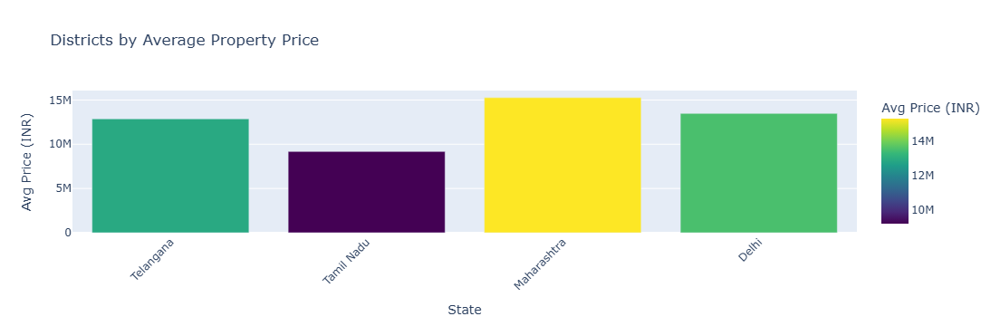

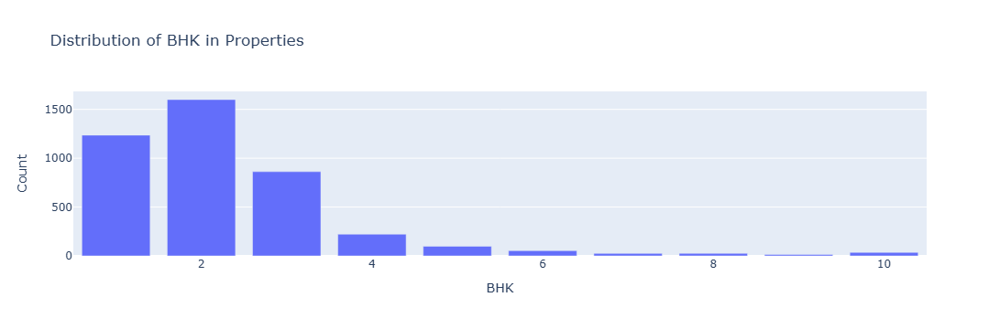

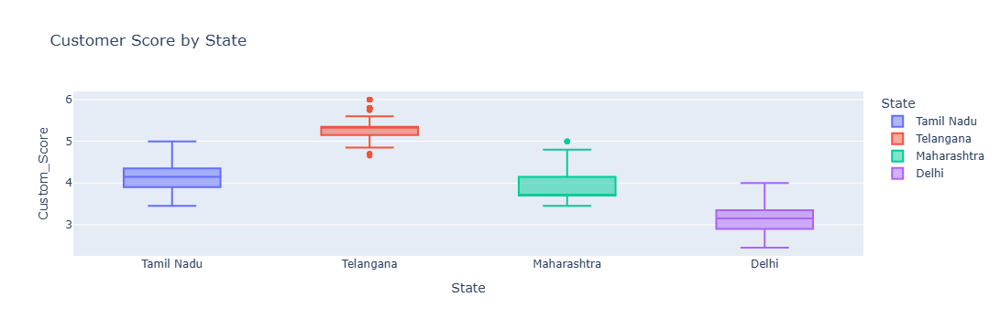

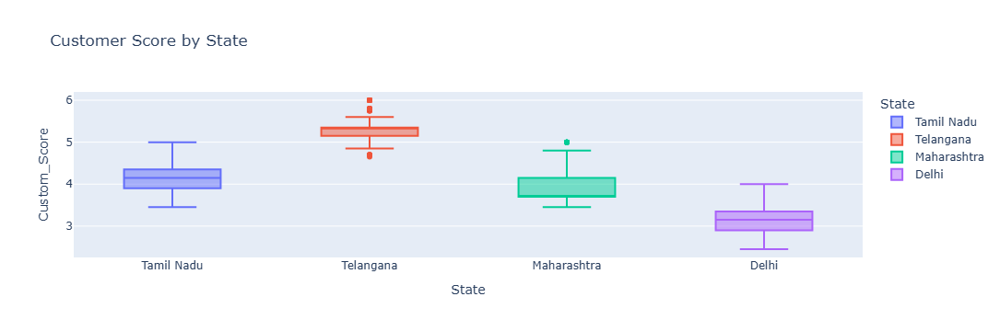

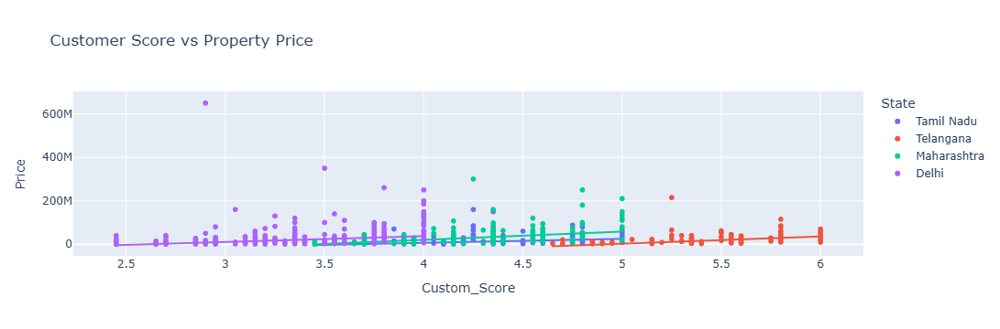

...

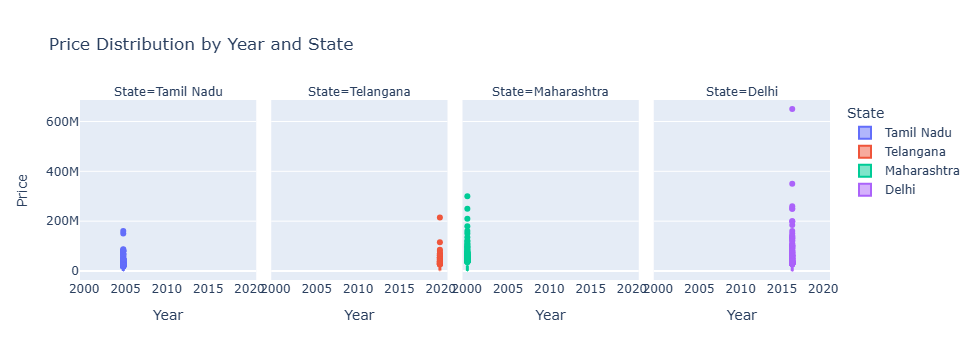

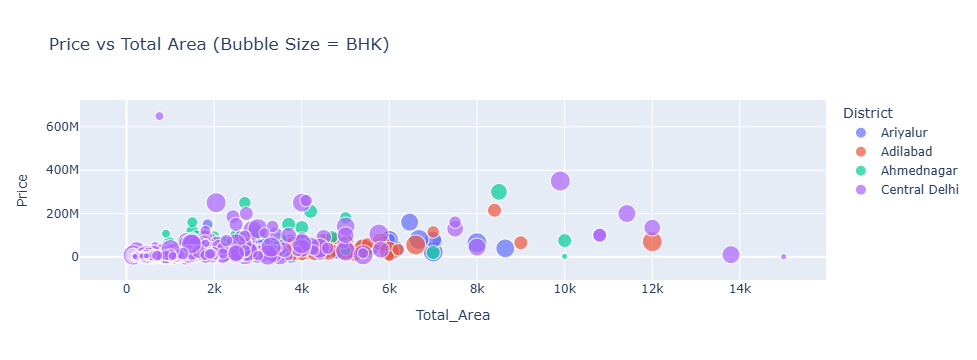

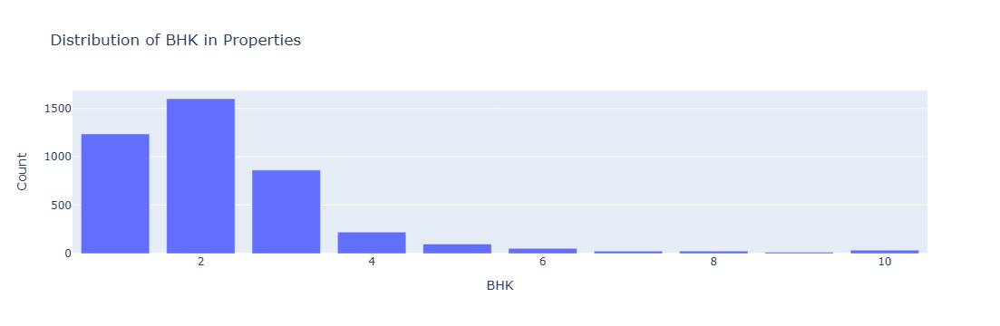

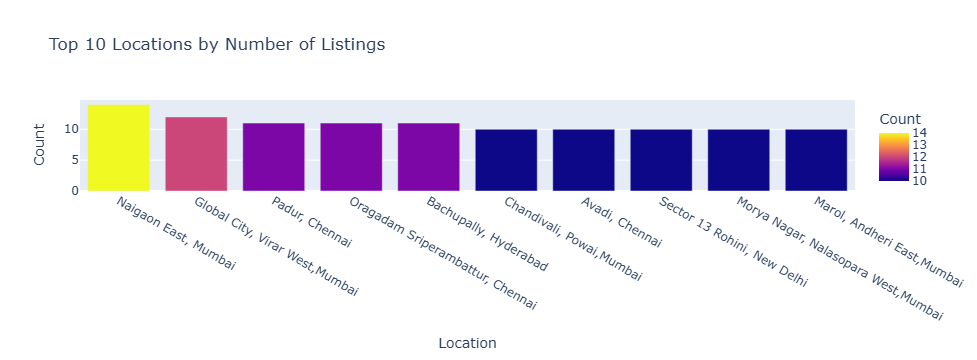

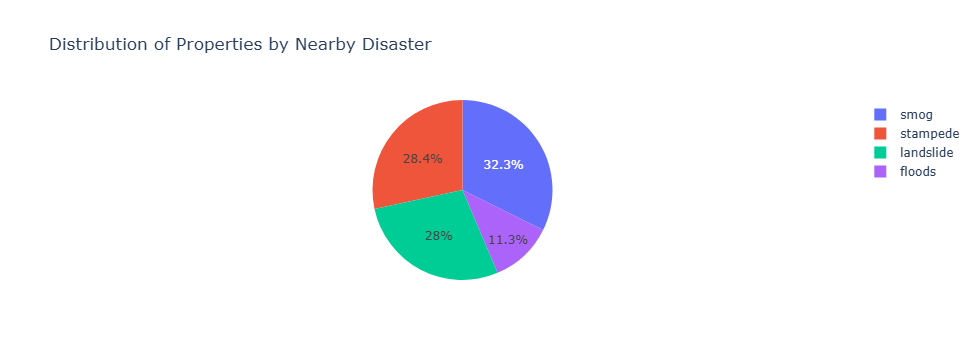

In [18]:

avg_price_by_district = (df.groupby("State")["Price"].mean().reset_index().sort_values("State", ascending=False))
fig = px.bar(avg_price_by_district.head(20),x="State",y="Price",title="Districts by Average Property Price",labels={"Price": "Avg Price (INR)"},color="Price",color_continuous_scale="Viridis")
fig.update_layout(xaxis_tickangle=-45)
fig.show()

fig = px.bar(bhk_counts.sort_values('BHK'),x="BHK",y="Count",title="Distribution of BHK in Properties")
fig.show()

fig = px.box(df, x='State', y='Custom_Score',title='Customer Score by State',color='State')
fig.show()

fig = px.box(df, x='State', y='Custom_Score',title='Customer Score by State',color='State')
fig.show()

fig = px.scatter(df, x='Custom_Score', y='Price',trendline='ols',title='Customer Score vs Property Price',color='State')
fig.show()

fig = px.scatter(df, x='Humidity (%)', y='Custom_Score',trendline='ols',title='Customer Score vs Humidity',color='State')
fig.show()

fig = px.scatter(df, x='Wind Speed (km/h)', y='Custom_Score',trendline='ols',title='Customer Score vs Wind Speed',color='State')
fig.show()

avg_price_year = df.groupby('Year')['Price'].mean().reset_index()
fig1 = px.line(avg_price_year, x='Year', y='Price',title='Average Property Price Per Year',markers=True)
fig1.show()

avg_area_year = df.groupby('Year')['Total_Area'].mean().reset_index()
fig3 = px.line(avg_area_year, x='Year', y='Total_Area',title='Average Total Area Per Year',markers=True)
fig3.show()

avg_bhk_year = df.groupby('Year')['BHK'].mean().reset_index()
fig4 = px.line(avg_bhk_year, x='Year', y='BHK',title='Average BHK Per Year',markers=True)
fig4.show()

avg_bath_year = df.groupby('Year')['Baths'].mean().reset_index()
fig5 = px.line(avg_bath_year, x='Year', y='Baths',title='Average Number of Bathrooms Per Year',markers=True)
fig5.show()

avg_price_by_district = (df.groupby("District")["Price"].mean().reset_index().sort_values("Price", ascending=False))
fig = px.bar(avg_price_by_district.head(20),x="District",y="Price",title="Districts by Average Property Price",labels={"Price": "Avg Price (INR)"},color="Price",color_continuous_scale="Viridis")
fig.update_layout(xaxis_tickangle=-45)
fig.show()

fig1 = px.scatter(df, x='Total_Area', y='Price',color='BHK',title='Price vs Total Area colored by BHK',hover_data=['State', 'Year'])
fig1.show()

fig = px.scatter(df, x='Total_Area', y='Price',size='BHK',color='State',animation_frame='Year',hover_name='District',title='Price vs Total Area Over Years (Bubble = BHK)',size_max=40)
fig.show()

grouped = df.groupby(['Year', 'State']).agg({'Price': 'mean','Total_Area': 'mean','BHK': 'mean'}).reset_index()
fig = px.line(grouped, x='Year', y='Price',color='State',markers=True,title='Average Price per State Over the Years')
fig.show()

fig2 = px.line(grouped, x='Year', y='Total_Area',color='State',markers=True,title='Average Area per State Over the Years')
fig2.show()

fig = px.box(df, x='Year', y='Price',color='State',title='Price Distribution by Year and State',facet_col='State',facet_col_wrap=4)
fig.show()

fig = px.scatter(df,x="Total_Area",y="Price",size="BHK",color="District",hover_data=["Location"],title="Price vs Total Area (Bubble Size = BHK)")
fig.show()

bhk_counts = df['BHK'].value_counts().reset_index()
bhk_counts.columns = ['BHK', 'Count']
fig = px.bar(bhk_counts.sort_values('BHK'),x="BHK",y="Count",title="Distribution of BHK in Properties")
fig.show()

top_locations = df['Location'].value_counts().nlargest(10).reset_index()
top_locations.columns = ['Location', 'Count']

fig = px.bar(top_locations,x="Location",y="Count",title="Top 10 Locations by Number of Listings",color="Count")
fig.show()

disaster_counts = df['Disaster'].value_counts().reset_index()
disaster_counts.columns = ['Disaster', 'Count']
fig = px.pie(disaster_counts,names="Disaster",values="Count",title="Distribution of Properties by Nearby Disaster")
fig.show()

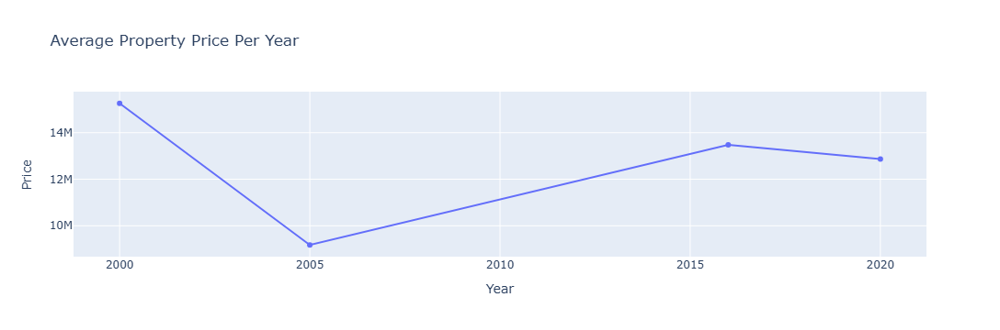

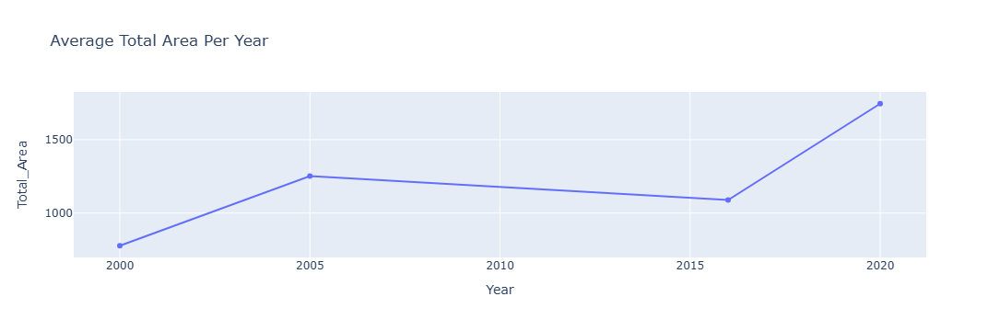

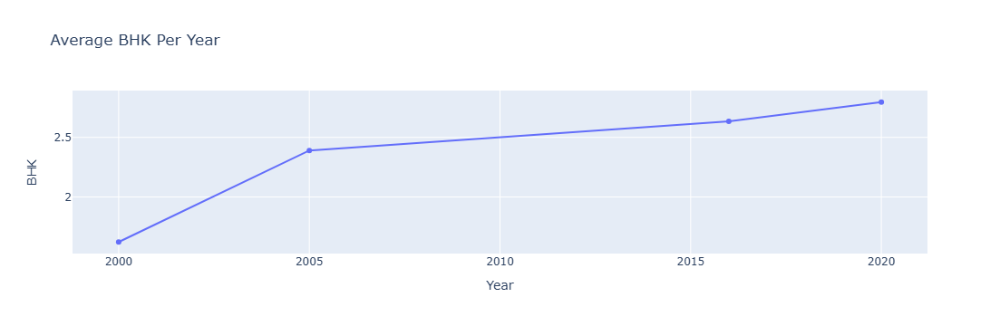

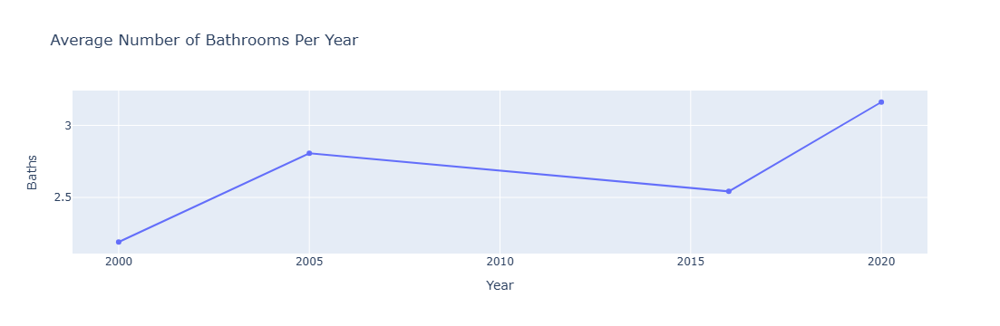

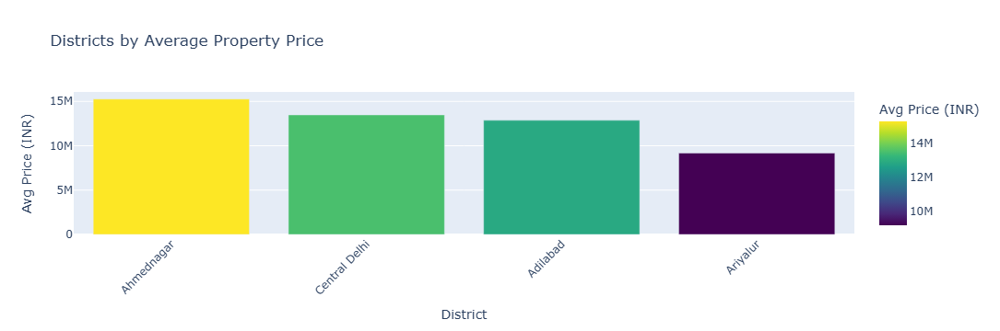

...

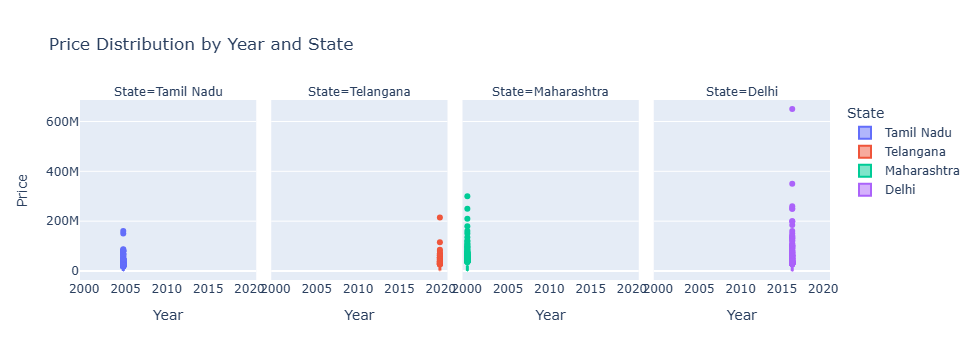

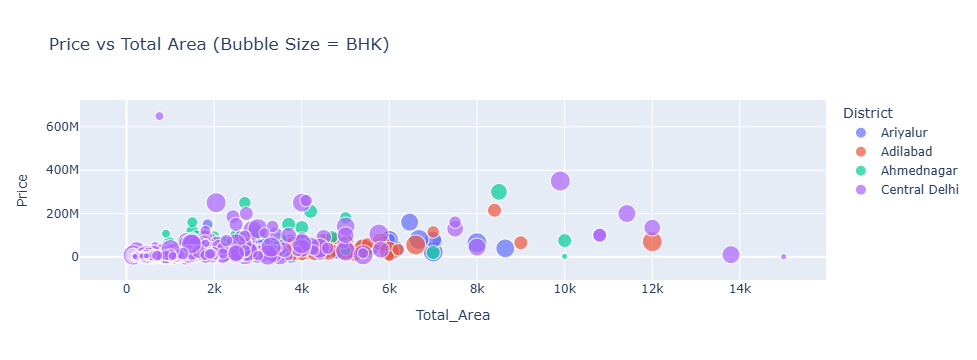

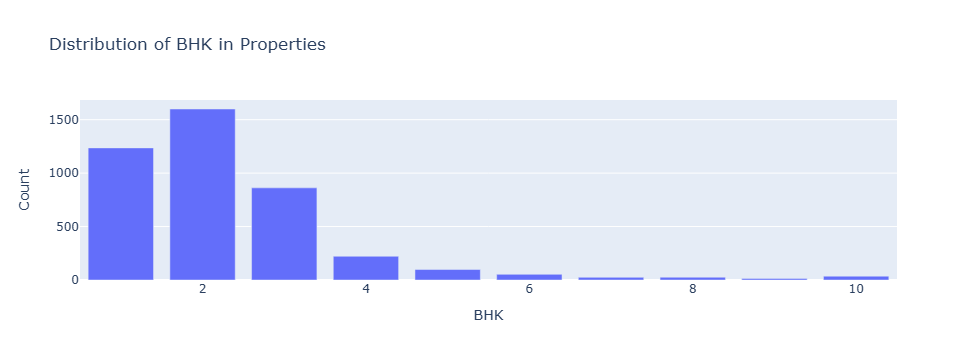

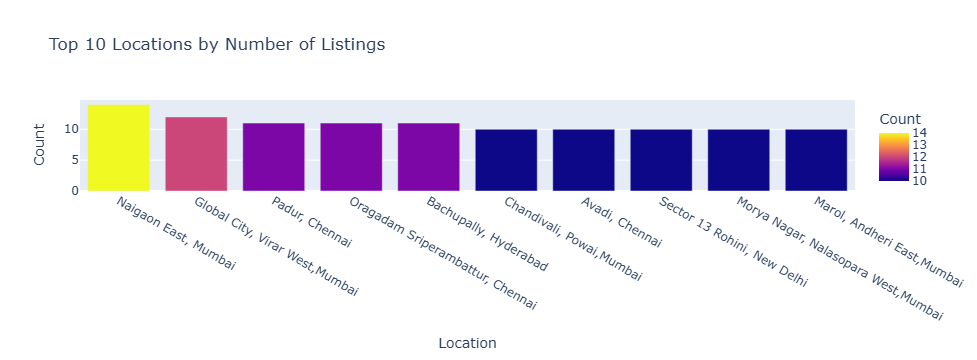

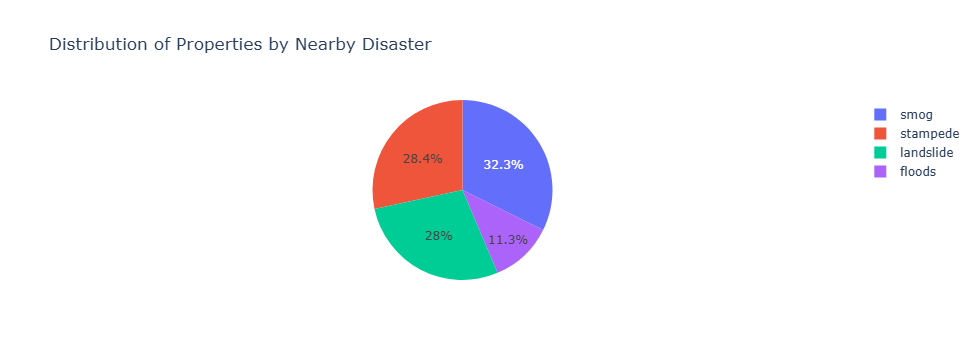

In [19]:
avg_price_year = df.groupby('Year')['Price'].mean().reset_index()
fig1 = px.line(avg_price_year, x='Year', y='Price',title='Average Property Price Per Year',markers=True)
fig1.show()

avg_area_year = df.groupby('Year')['Total_Area'].mean().reset_index()
fig3 = px.line(avg_area_year, x='Year', y='Total_Area',title='Average Total Area Per Year',markers=True)
fig3.show()

avg_bhk_year = df.groupby('Year')['BHK'].mean().reset_index()
fig4 = px.line(avg_bhk_year, x='Year', y='BHK',title='Average BHK Per Year',markers=True)
fig4.show()

avg_bath_year = df.groupby('Year')['Baths'].mean().reset_index()
fig5 = px.line(avg_bath_year, x='Year', y='Baths',title='Average Number of Bathrooms Per Year',markers=True)
fig5.show()

avg_price_by_district = (df.groupby("District")["Price"].mean().reset_index().sort_values("Price", ascending=False)
)
fig = px.bar(avg_price_by_district.head(20),x="District",y="Price",title="Districts by Average Property Price",labels={"Price": "Avg Price (INR)"},color="Price",color_continuous_scale="Viridis")
fig.update_layout(xaxis_tickangle=-45)
fig.show()

fig1 = px.scatter(df, x='Total_Area', y='Price',color='BHK',title='Price vs Total Area colored by BHK',hover_data=['State', 'Year'])
fig1.show()

fig = px.scatter(df, x='Total_Area', y='Price',size='BHK',color='State',animation_frame='Year',hover_name='District',title='Price vs Total Area Over Years (Bubble = BHK)',size_max=40)
fig.show()

grouped = df.groupby(['Year', 'State']).agg({'Price': 'mean','Total_Area': 'mean','BHK': 'mean'}).reset_index()
fig = px.line(grouped, x='Year', y='Price',color='State',markers=True,title='Average Price per State Over the Years')
fig.show()

fig2 = px.line(grouped, x='Year', y='Total_Area',color='State',markers=True,title='Average Area per State Over the Years')
fig2.show()

fig = px.box(df, x='Year', y='Price',color='State',title='Price Distribution by Year and State',facet_col='State',facet_col_wrap=4)
fig.show()

fig = px.scatter(df,x="Total_Area",y="Price",size="BHK",color="District",hover_data=["Location"],title="Price vs Total Area (Bubble Size = BHK)")
fig.show()

bhk_counts = df['BHK'].value_counts().reset_index()
bhk_counts.columns = ['BHK', 'Count']
fig = px.bar(bhk_counts.sort_values('BHK'),x="BHK",y="Count",title="Distribution of BHK in Properties")
fig.show()

top_locations = df['Location'].value_counts().nlargest(10).reset_index()
top_locations.columns = ['Location', 'Count']

fig = px.bar(top_locations,x="Location",y="Count",title="Top 10 Locations by Number of Listings",color="Count")
fig.show()

disaster_counts = df['Disaster'].value_counts().reset_index()
disaster_counts.columns = ['Disaster', 'Count']
fig = px.pie(disaster_counts,names="Disaster",values="Count",title="Distribution of Properties by Nearby Disaster")
fig.show()



## insights
• Property prices have increased steadily over the years.  
• Average built-up area is gradually rising year by year.  
• Average BHK count is slowly increasing, showing demand for bigger homes.  
• Number of bathrooms per property is slightly increasing.  
• Some districts have much higher average property prices than others.  
• Larger area and higher BHKs usually lead to higher property prices.  
• Price vs area trends vary over the years across different states.  
• Some states consistently show higher average property prices.  
• Average property size differs by state over the years.  
• Price distribution by year and state shows wide variation.  
• 2BHK and 3BHK are the most common property types.  
• Top 10 locations have the highest number of property listings.  
• Most properties are in low disaster-risk zones.


## Multivariate

## Multivariate Analysis

In [20]:
ig1 = px.scatter(df, x='Total_Area', y='Price', color='BHK',title='Price vs Total Area (Colored by BHK)',width=900, height=500)
fig1.show()

fig2 = px.box(df, x='BHK', y='Price', color='BHK',title='Price Distribution by BHK',width=900, height=500)
fig2.show()

fig3 = px.box(df, x='State', y='Price', color='State',title='Property Price Distribution by State',width=1000, height=500)
fig3.show()

heatmap_data = df.groupby(['BHK', 'Baths']).size().reset_index(name='Count')
fig4 = px.density_heatmap(heatmap_data, x='BHK', y='Baths', z='Count',color_continuous_scale='YlGnBu',title='Heatmap of BHK vs Baths',width=700, height=500)
fig4.show()

fig5 = px.box(df, x='Balcony', y='Price', color='Balcony',title='Price Distribution by Balcony Availability',width=800, height=500)
fig5.show()

fig6 = px.scatter(df, x='Temperature (°C)', y='Price', color='State',title='Price vs Temperature by State',width=900, height=500)
fig6.show()

fig7 = px.scatter(df, x='Humidity (%)', y='Price', color='State',title='Price vs Humidity by State',width=900, height=500)
fig7.show()

fig8 = px.scatter(df, x='Wind Speed (km/h)', y='Price', color='State',title='Price vs Wind Speed by State', width=900, height=500)
fig8.show()

fig1 = px.scatter(df, x='Total_Area', y='Price',color='BHK', size='Baths',hover_data=['State'],title='Total Area vs Price (Color: BHK, Size: Baths)',width=1000, height=600)
fig1.show()

fig2 = px.scatter_3d(df, x='Total_Area', y='BHK', z='Price',color='State',size='Baths',title='3D Scatter: Area, BHK, and Price',width=1000, height=700)
fig2.show()

fig5 = px.box(df, x='Disaster', y='Price', color='BHK',title='Price Distribution by Disaster Type and BHK',width=1000, height=600)
fig5.show()

fig3 = px.sunburst(df,path=['State', 'BHK', 'Balcony'],values='Price',color='State',title='Sunburst: Price by State → BHK → Balcony',width=900, height=700)
fig3.show()

fig = px.scatter(df, x='Total_Area', y='Price',size='Custom_Score', color='State',title='Multivariate View: Area vs Price vs Score',hover_data=['Location'])
fig.show()

fig = px.scatter(df, x='Total_Area', y='Price',size='Custom_Score', color='State',title='Multivariate View: Area vs Price vs Score',hover_data=['Location'])
fig.show()

fig5 = px.sunburst(df,path=['Disaster', 'BHK', 'Balcony'],values='Price',color='Disaster',title='Sunburst: Price by Disaster → BHK → Balcony',width=900, height=700)
fig5.show()



## insights

• Price climbs almost linearly with total area, and the highest‑BHK points sit at the expensive end.  
• Median price rises with each extra BHK, and the spread widens sharply for 4 BHK and larger.  
• A few states plot much higher price boxes than the rest, revealing clear geographic premiums.  
• Heatmap shows most listings cluster at 2 BHK + 2 baths, while bigger bath counts grow scarce as BHK increases.  
• Having at least one balcony adds a modest price premium over homes with none.  
• Temperature has little overall effect on price, aside from a few cool‑climate outliers that sell higher.  
• Higher humidity nudges prices downward, hinting that muggy zones are valued slightly less.  
• Wind speed shows almost no relationship to price, except some cheaper high‑wind coastal listings.  
• Bubble plot confirms extra baths track with bigger area and higher price, tightening the area‑price link.  
• 3‑D scatter reveals that, at the same area, adding BHK lifts price sharply, with states forming distinct price “layers.”  
• Flood‑ or quake‑prone properties list cheaper than low‑risk ones, especially in higher‑BHK categories.  
• Sunburst (State → BHK → Balcony) shows most value comes from 2–3 BHK homes with one balcony in the top‑price states.  
• High customer‑score bubbles cluster among larger, costlier properties, connecting quality perception to price.  
• Disaster‑based sunburst highlights that low‑risk 2 BHK with a balcony dominates market value, while high‑risk large homes add little.


## Insights

## overall Insights and Summary


##  Insights and Summary

• Price climbs almost linearly with total area, and the highest‑BHK points sit at the expensive end.  
•price rises with each extra BHK, and the spread widens sharply for 4 BHK and larger.  
• A few states plot much higher price boxes than the rest, revealing clear geographic premiums.  
• Heatmap shows most listings cluster at 2 BHK + 2 baths, while bigger bath counts grow scarce as BHK increases.  
• Having at least one balcony adds a modest price premium over homes with none.  
• Temperature has little overall effect on price, aside from a few cool‑climate outliers that sell higher.  
• Higher humidity nudges prices downward, hinting that muggy zones are valued slightly less.  
• Wind speed shows almost no relationship to price, except some cheaper high‑wind coastal listings.  
• Bubble plot confirms extra baths track with bigger area and higher price, tightening the area‑price link.  
• 3‑D scatter reveals that, at the same area, adding BHK lifts price sharply, with states forming distinct price “layers.”  
• Flood‑ or quake‑prone properties list cheaper than low‑risk ones, especially in higher‑BHK categories.  
• Sunburst (State → BHK → Balcony) shows most value comes from 2–3 BHK homes with one balcony in the top‑price states.  
• High customer‑score bubbles cluster among larger, costlier properties, connecting quality perception to price.  
• Disaster‑based sunburst highlights that low‑risk 2 BHK with a balcony dominates market value, while high‑risk large homes add little.


## Conclusion
Property prices are mainly influenced by house features, location, climate, and disaster risk.
Prices have steadily increased over the years, especially in developed and safe areas.
2BHK and 3BHK homes are the most preferred for their space and affordability.
Larger area, more bathrooms, and balconies usually lead to higher property prices.
People prefer regions with moderate temperature and lower humidity.
Low disaster-prone areas like flood-free and earthquake-safe zones have higher value.
States with better infrastructure and job opportunities show strong price growth.
Customer scores are higher for properties in climate-friendly and well-connected locations.

